# PAGET aggr

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import mnnpy as mnnpy
import numba as numba
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()

/home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}
/home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/mnnpy/utils.py:14: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "l2_norm" failed type inference due to: Invalid use of Function(<function norm at 0x7fcbfc5534d0>) with argument(s) of type(s): (axis=Literal[int](1), x=array(float32, 2d, A))
 * parameterized
In definition 0:
    TypeError: norm_impl() got an unexpected keyword argument 'x'
    raised from /home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/numba/typing/templates.py:517
In definition 1:
    TypeError: norm_impl() got an unexpected keyword argument 'x'
    raised from /home/lebrigand/.conda/envs/jupyter/lib/python3.7/s

/home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/mnnpy/utils.py:199: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "adjust_s_variance" failed type inference due to: Untyped global name 'sq_dist_to_line': cannot determine Numba type of <class 'numba.ir.UndefinedType'>

File "../../../../home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/mnnpy/utils.py", line 209:
def adjust_s_variance(data1, data2, curcell, curvect, sigma):
    <source elided>
        sameproj = np.dot(grad, samecell)
        samedist = sq_dist_to_line(curcell, grad, samecell)
        ^

  @jit(float32(float32[:, :], float32[:, :], float32[:], float32[:], float32), nogil=True)
/home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/mnnpy/utils.py:199: NumbaWarning: 
Compilation is falling back to object mode WITHOUT looplifting enabled because Function "adjust_s_variance" failed type inference due to: cannot determine Numba type of 

scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.10 numpy==1.17.3 scipy==1.4.1 pandas==0.25.3 scikit-learn==0.21.3 statsmodels==0.10.2 python-igraph==0.7.1 louvain==0.6.1


In [2]:
sc.settings.set_figure_params(dpi=130)

# Loading 10x data
[Back to top](#Full-Aggregate)

In [3]:
adata = sc.read_h5ad('./output/adata.preprocessing.h5ad')
adata.raw = adata
print("adata shape = ", adata.shape)
adata.obs['sample']

adata shape =  (7471, 12667)


index
AAACCTGAGATAGGAG-1-0    wt
AAACCTGCAAACTGCT-1-0    wt
AAACCTGCACAGAGGT-1-0    wt
AAACCTGCACGAGGTA-1-0    wt
AAACCTGCAGTCAGCC-1-0    wt
                        ..
TTTGTCAGTCTTGTCC-1-1    ko
TTTGTCATCACCAGGC-1-1    ko
TTTGTCATCGATCCCT-1-1    ko
TTTGTCATCGCTGATA-1-1    ko
TTTGTCATCTGATACG-1-1    ko
Name: sample, Length: 7471, dtype: category
Categories (2, object): [ko, wt]

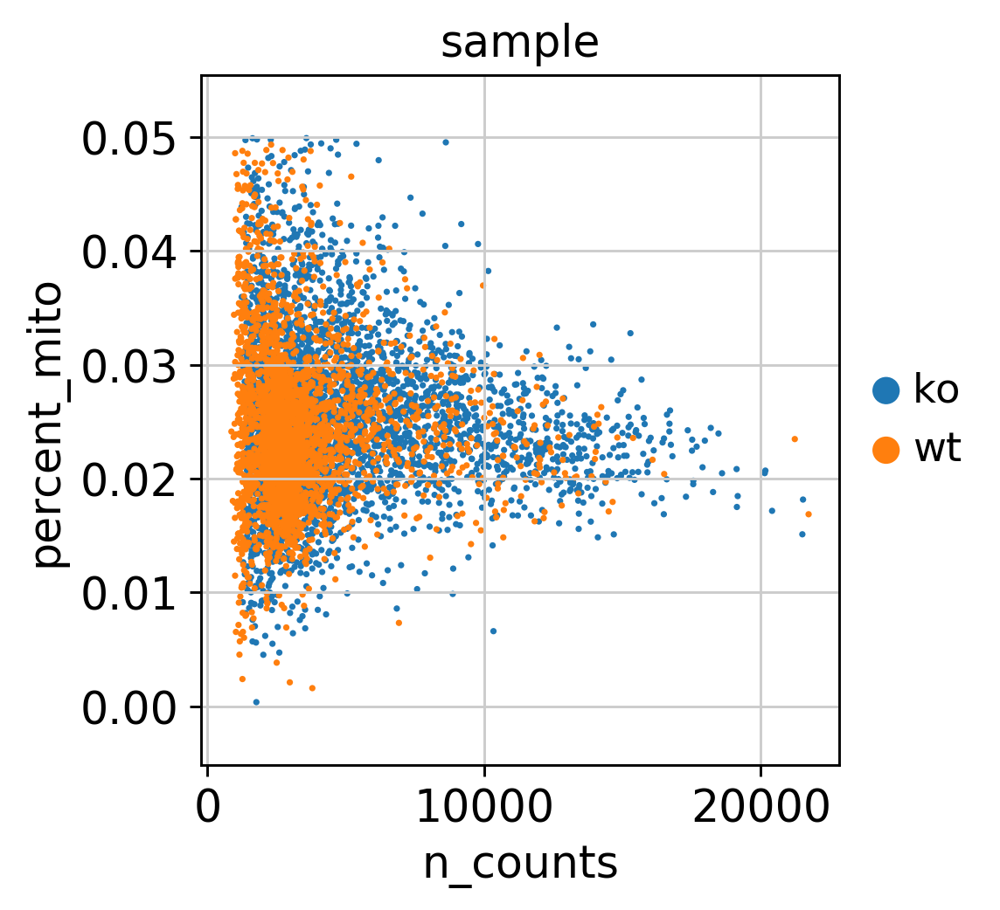

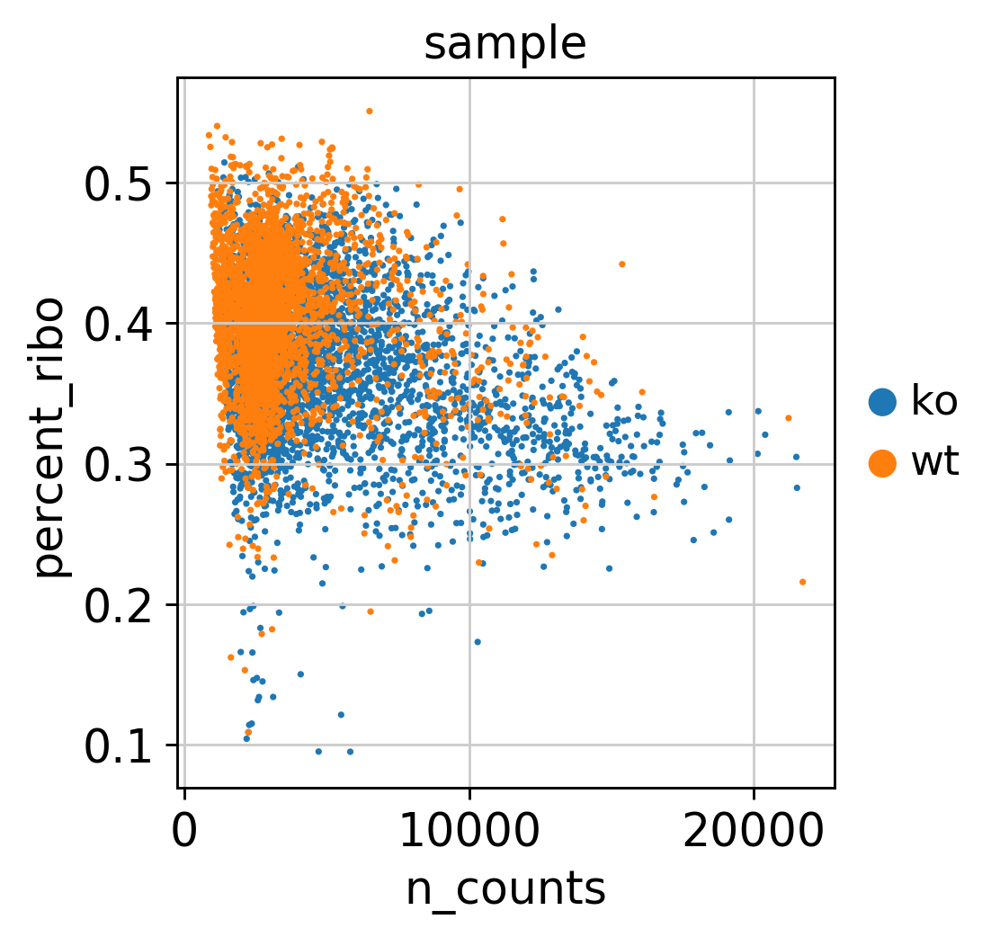

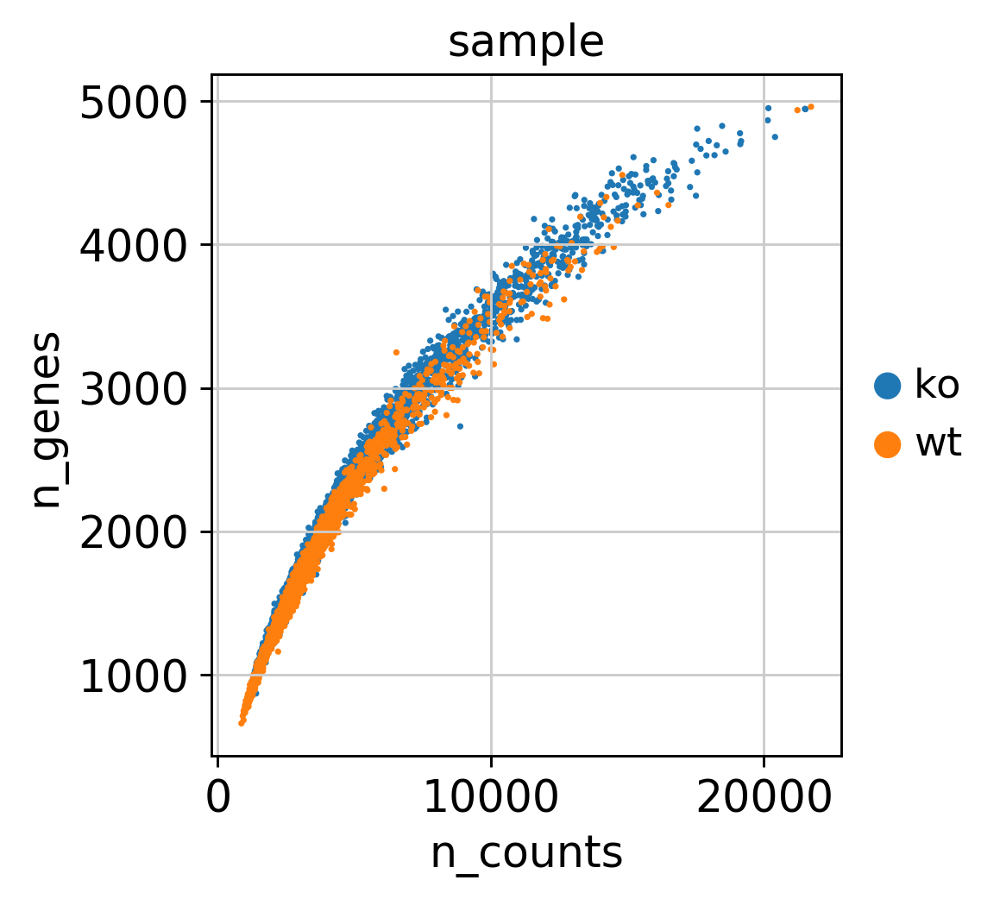

In [4]:
sc.pl.scatter(adata, x='n_counts', y='percent_mito', color="sample")
sc.pl.scatter(adata, x='n_counts', y='percent_ribo', color="sample")
sc.pl.scatter(adata, x='n_counts', y='n_genes', color="sample")

extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


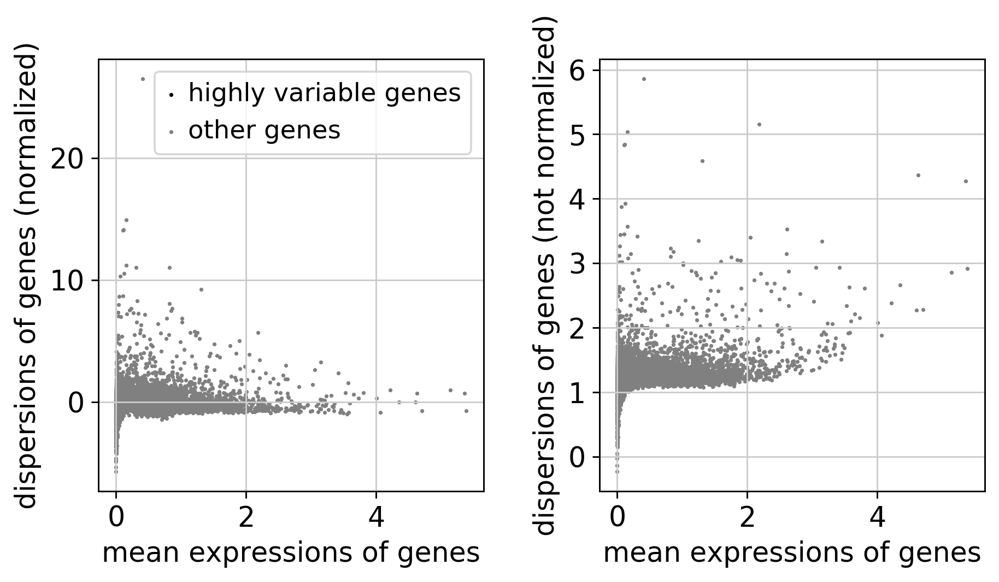

In [5]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.25, batch_key='sample')
sc.pl.highly_variable_genes(adata)

In [6]:
adata_wt = adata[adata.obs['sample'].isin(['wt'])]
adata_ko = adata[adata.obs['sample'].isin(['ko'])]
print("wt shape = ", adata_wt.shape)
print("ko shape = ", adata_ko.shape)

wt shape =  (3290, 12667)
ko shape =  (4181, 12667)


In [7]:
hvgs = adata.var.loc[adata.var['highly_variable_intersection'] == True, :].index
hvgs

Index(['Rb1cc1', '4732440D04Rik', 'Pcmtd1', 'Lactb2', 'Mcm3', 'Paqr8', 'Kcnq5',
       'Neurl3', 'Arid5a', 'Inpp4a',
       ...
       'Pdcd4', 'Adrb1', 'Ccdc186', 'B230217O12Rik', 'Pdzd8', 'Fam204a',
       'Fam45a', 'Zfp950', 'AC133103.1', 'PISD'],
      dtype='object', name='index', length=1852)

In [8]:
corrected = mnnpy.mnn_correct(adata_wt, adata_ko, var_subset=hvgs, save_raw= True, batch_categories = ["wt", "ko"])

Performing cosine normalization...
Starting MNN correct iteration. Reference batch: 0
Step 1 of 1: processing batch 1
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
MNN correction complete. Gathering output...
Packing AnnData object...
Done.


In [9]:
adata = corrected[0]
adata.write('./output/adata.mnncorrect.h5ad')

... storing 'sample' as categorical


In [10]:
def get_cluster_proportions(adata,
                            cluster_key="cluster_final",
                            sample_key="replicate",
                            drop_values=None):
    """
    Input
    =====
    adata : AnnData object
    cluster_key : key of `adata.obs` storing cluster info
    sample_key : key of `adata.obs` storing sample/replicate info
    drop_values : list/iterable of possible values of `sample_key` that you don't want
    
    Returns
    =======
    pd.DataFrame with samples as the index and clusters as the columns and 0-100 floats
    as values
    """
    
    adata_tmp = adata.copy()
    sizes = adata_tmp.obs.groupby([cluster_key, sample_key]).size()
    props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index() 
    props = props.pivot(columns=sample_key, index=cluster_key).T
    props.index = props.index.droplevel(0)
    props.fillna(0, inplace=True)
    
    if drop_values is not None:
        for drop_value in drop_values:
            props.drop(drop_value, axis=0, inplace=True)
    return props


def plot_cluster_proportions(cluster_props, 
                             cluster_palette=None,
                             xlabel_rotation=0): 
    fig, ax = plt.subplots(dpi=130)
    fig.patch.set_facecolor("white")
    
    cmap = None
    if cluster_palette is not None:
        cmap = sns.palettes.blend_palette(
            cluster_palette, 
            n_colors=len(cluster_palette), 
            as_cmap=True)
   
    cluster_props.plot(
        kind="bar", 
        stacked=True, 
        ax=ax, 
        legend=None, 
        colormap=cmap
    )
    
    ax.legend(bbox_to_anchor=(1.01, 1), frameon=False, title="Cluster")
    sns.despine(fig, ax)
    ax.tick_params(axis="x", rotation=xlabel_rotation)
    ax.set_xlabel(cluster_props.index.name.capitalize())
    ax.set_ylabel("Proportion")
    fig.tight_layout()
    
    return fig

In [11]:
#adata = sc.read_h5ad('./output/adata.mnncorrect.h5ad')
print("adata shape = ", adata.shape)
adata.obs

adata shape =  (7471, 12667)


,batch,doubletDetection,doublet_scores,n_counts,n_genes,percent_mito,percent_ribo,predicted_doublets,sample
AAACCTGAGATAGGAG-1-0-wt,wt,0.0,0.063116,13080.0,3882,0.023835,0.282081,False,wt
AAACCTGCAAACTGCT-1-0-wt,wt,0.0,0.144465,2564.0,1532,0.027186,0.472325,False,wt
AAACCTGCACAGAGGT-1-0-wt,wt,0.0,0.063116,3464.0,1729,0.019697,0.418037,False,wt
AAACCTGCACGAGGTA-1-0-wt,wt,0.0,0.235632,2489.0,1472,0.021231,0.392310,False,wt
AAACCTGCAGTCAGCC-1-0-wt,wt,0.0,0.044776,1833.0,1205,0.035033,0.329171,False,wt
...,...,...,...,...,...,...,...,...,...
TTTGTCAGTCTTGTCC-1-1-ko,ko,0.0,0.131098,11167.0,3616,0.028288,0.401760,False,ko
TTTGTCATCACCAGGC-1-1-ko,ko,0.0,0.140549,2846.0,1657,0.026615,0.327116,False,ko
TTTGTCATCGATCCCT-1-1-ko,ko,0.0,0.131098,3595.0,1964,0.023084,0.298392,False,ko
TTTGTCATCGCTGATA-1-1-ko,ko,0.0,0.115068,1603.0,1083,0.022765,0.442250,False,ko


In [12]:
adata.var['highly_variable'] = adata.var['highly_variable_intersection']

In [13]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:01)


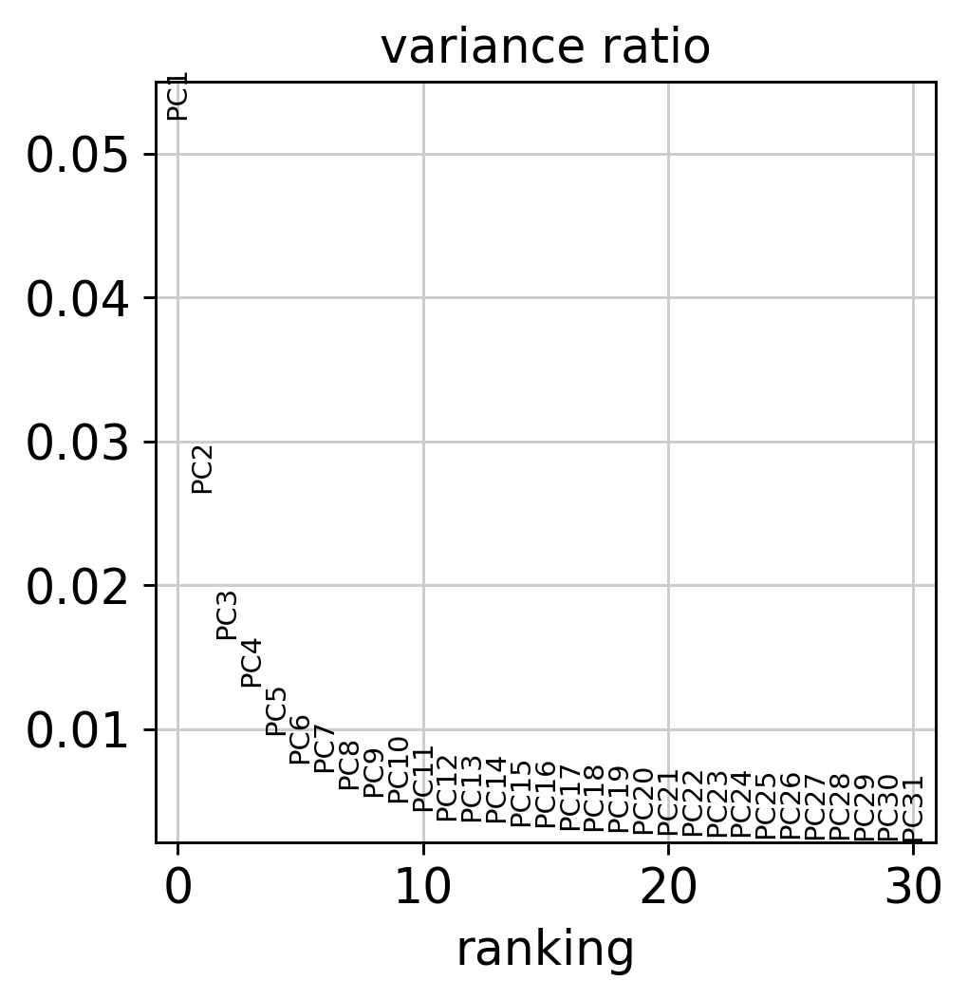

In [14]:
sc.pl.pca_variance_ratio(adata, log = False)

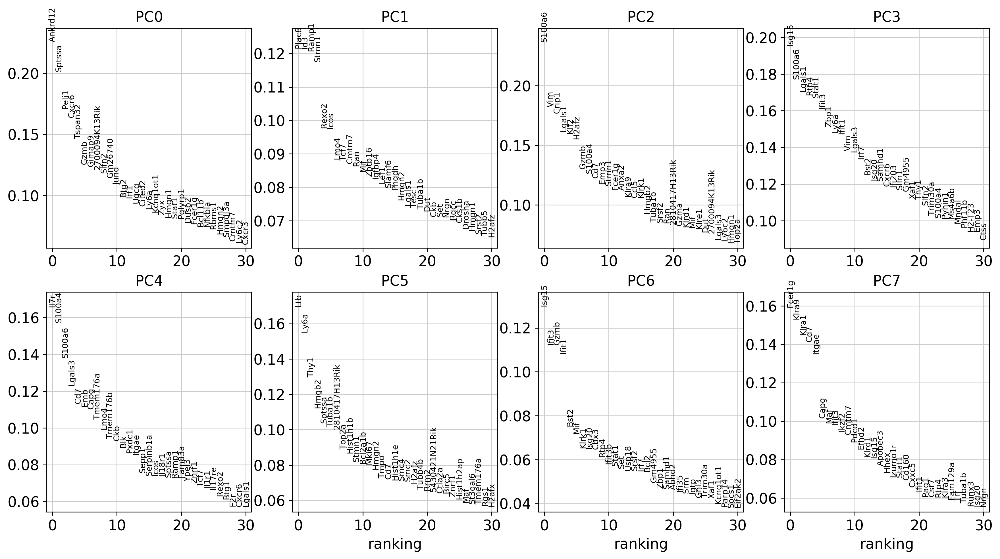

In [15]:
sc.pl.pca_loadings(adata, components=list(range(0,8)))

In [16]:
sc.pp.neighbors(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:03)


In [17]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:21)


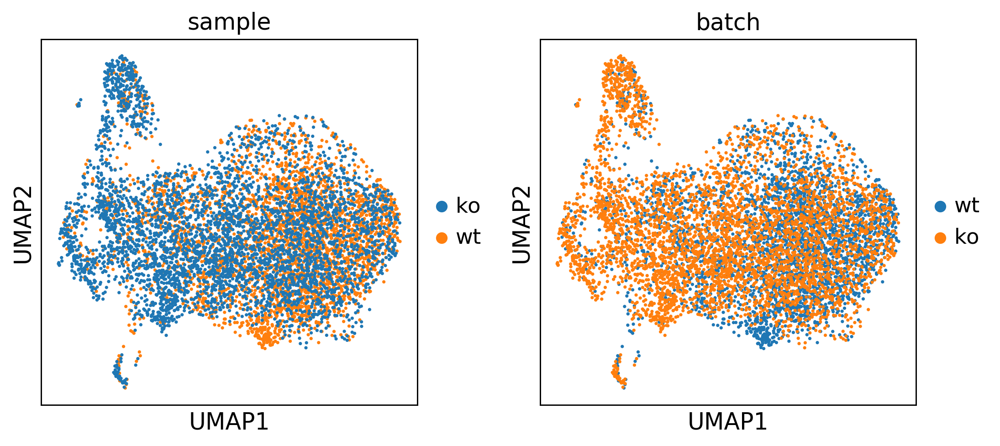

In [18]:
sc.pl.umap(adata, color=['sample','batch'], edges = False)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 18 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


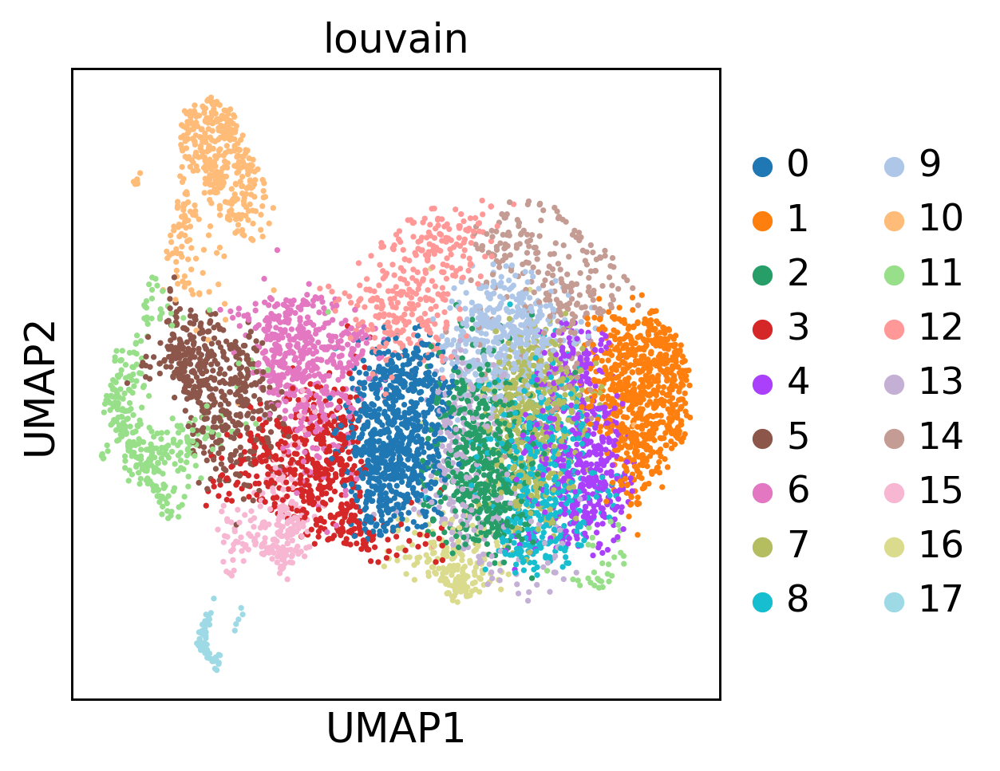

In [19]:
#metadata = pd.read_csv('preprocessing_metadata.tsv', sep = '\t')
#adata.obs['cell_type'] = metadata['cell_type']
sc.tl.louvain(adata, resolution=2)
sc.pl.umap(adata, color=['louvain'])

In [20]:
communities, graph, Q = sc.external.tl.phenograph(adata.obsm['X_pca'][:,0:10], k=100)

PhenoGraph clustering
    finished (0:00:25)


In [21]:
adata.obs['phenograph'] = pd.Categorical(communities)

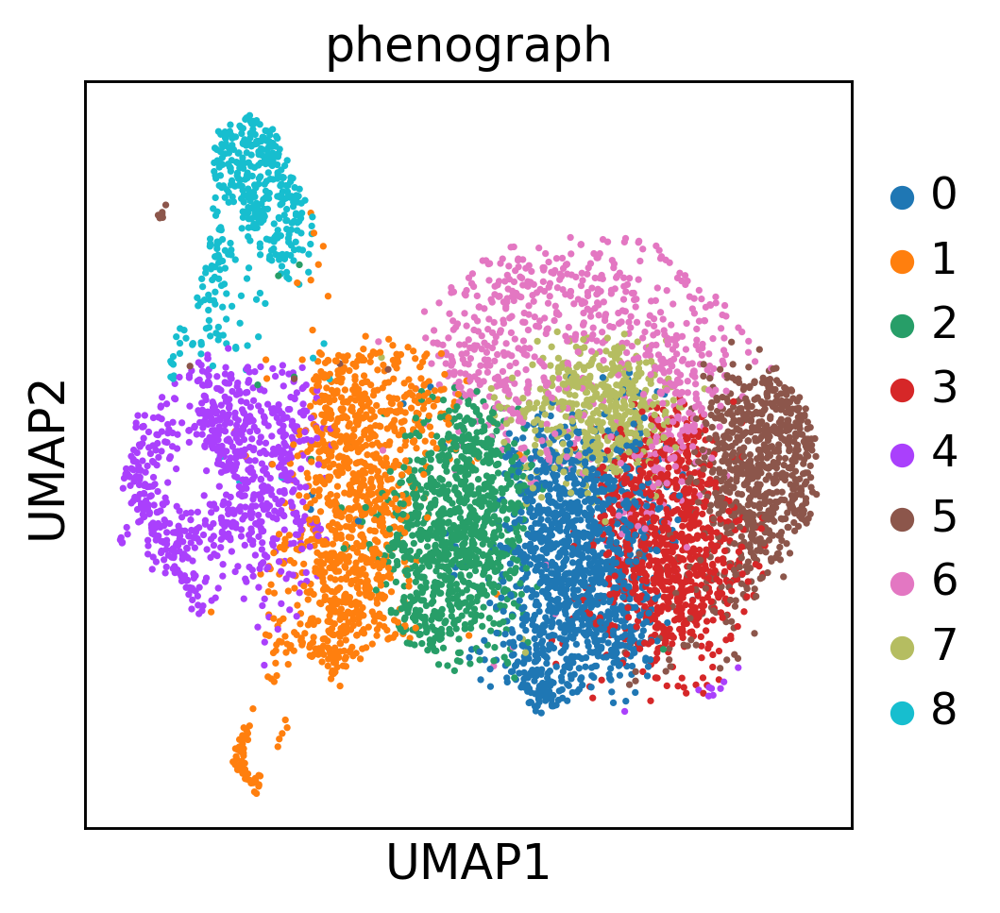

In [22]:
sc.pl.umap(adata, color=['phenograph'])

In [23]:
prop = get_cluster_proportions(adata,"sample","louvain")
prop

sample,ko,wt
louvain,,
0,68.693402,31.306598
1,42.274052,57.725948
2,54.631380,45.368620
3,61.787072,38.212928
4,40.661479,59.338521
5,81.744422,18.255578
6,65.062762,34.937238
7,33.615222,66.384778
8,45.617978,54.382022


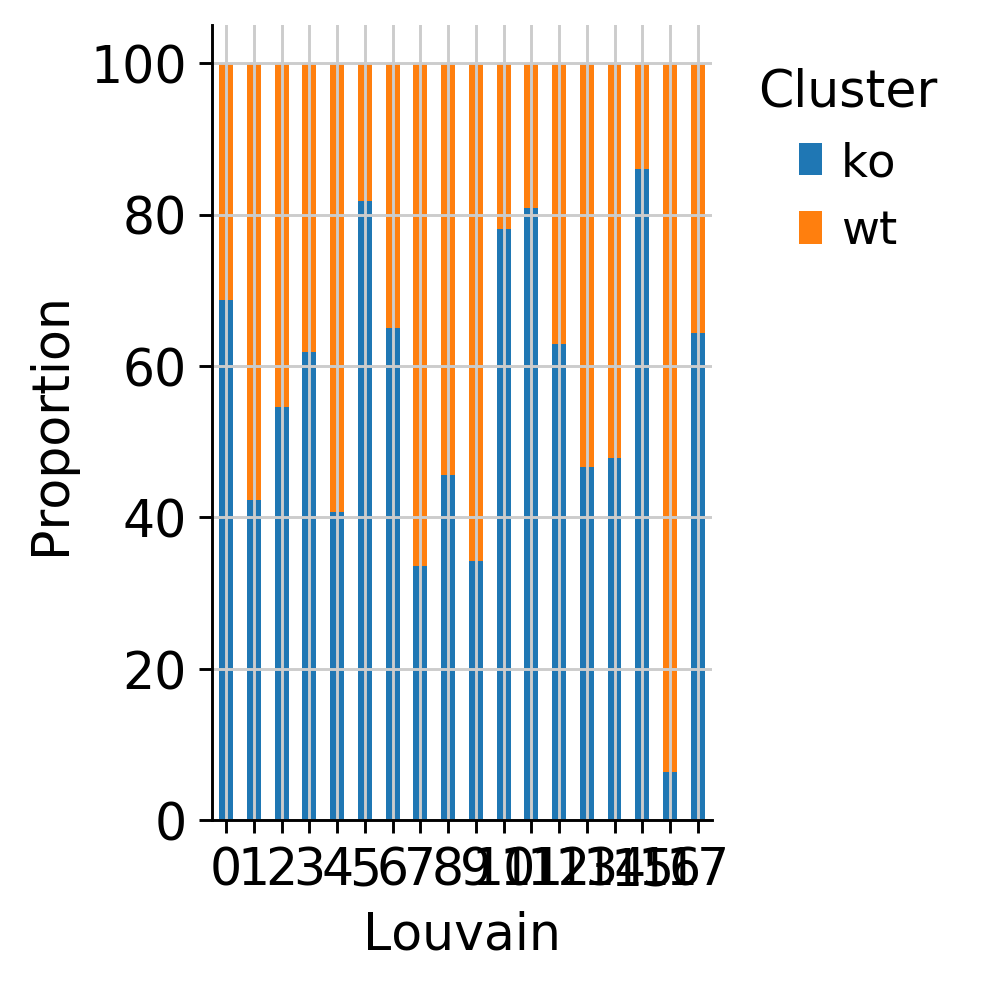

In [24]:
plot = plot_cluster_proportions(prop)

In [25]:
sc.tl.rank_genes_groups(adata, 'louvain')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


In [26]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,Izumo1r,Klf2,AW112010,Izumo1r,Gzmb,Stmn1,Ifi27l2a,Nkg7,Klra9,Ifngr1,Emb,Stmn1,Ifit3,Nkg7,Ifit3,Nrgn,Eef1a1,Sox4
1,Cmtm7,Fcer1g,Klrd1,Zbtb16,Nkg7,Ptma,Tesc,Ctla2a,Klrd1,Ltb,Pxdc1,2810417H13Rik,Isg15,Gimap4,Ms4a4b,Lef1,Gm10073,Lef1
2,Smpdl3a,S100a6,Malat1,Ramp1,Cd7,Cks1b,Plac8,Klrb1c,Klrb1c,H2-K1,Fam83a,Top2a,Stat1,Id2,Isg15,Ccr9,Cd3e,Itm2a
3,Slamf6,Ccl5,Nkg7,Eef1b2,Xcl1,Hmgn2,Ramp1,Bcl2,Nkg7,Nkg7,Ckb,Mki67,Ifit1,Bcl2,Ifit1,Pdcd1,Fth1,Ldhb
4,Ramp1,Nkg7,Ltb,2600014E21Rik,Klrd1,Igfbp4,Ass1,Klrd1,AW112010,Ms4a4b,Blk,Smc2,Irf7,Gimap6,Rtp4,Plac8,Ly6a,Gm43352
5,Ctsd,Cd7,Id2,Cmtm7,Klrb1c,H2afz,Naca,Gzmb,Ly6c2,AW112010,Lmo4,Hmgb2,Rtp4,Gimap3,Gm4955,Lztfl1,Fhl2,H3f3a
6,Icos,Crip1,Ctsw,Zfos1,Styk1,Ran,Il6ra,Thy1,Id2,Ctla2a,Il17re,Rrm2,Zbp1,AW112010,Gzmb,2600014E21Rik,Cd3g,Marcksl1
7,Drosha,Klra9,Ctsd,Icos,Fcer1g,2700094K13Rik,Slamf6,Id2,Cd7,Cxcr6,Tmem176a,Asf1b,Isg20,Il2rb,Ifi203,Id3,Ltb,Myb
8,Ptprcap,Gzma,H2-K1,Tcf7,Sh3bgrl3,Tesc,Id3,Gimap3,Il2rb,H2-D1,Il1r1,Cks1b,Slfn1,Klrb1c,Cd7,Zbtb16,Gm9843,Slc29a1
9,Gimap4,Klre1,S100a11,Eef1g,Klrk1,Lgals1,Ccr7,Ms4a4b,Klrk1,Fgl2,Ramp1,Ptma,Ifi27l2a,Ptpn6,Irf7,Slc29a1,Klrd1,Id3


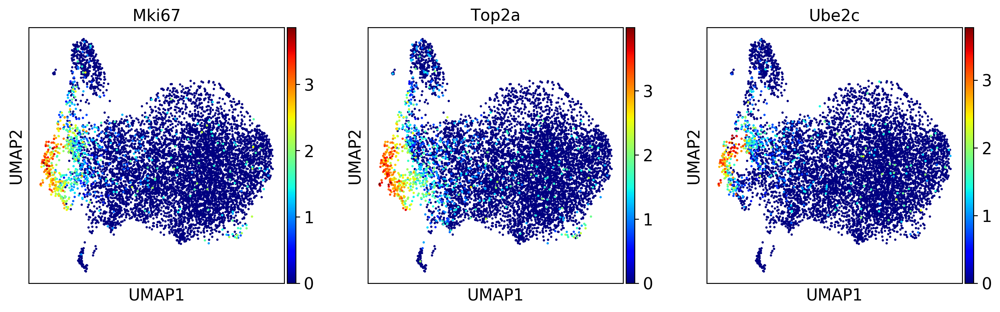

In [27]:
sc.pl.umap(adata, color=['Mki67', 'Top2a', 'Ube2c'], color_map="jet") # Cycling

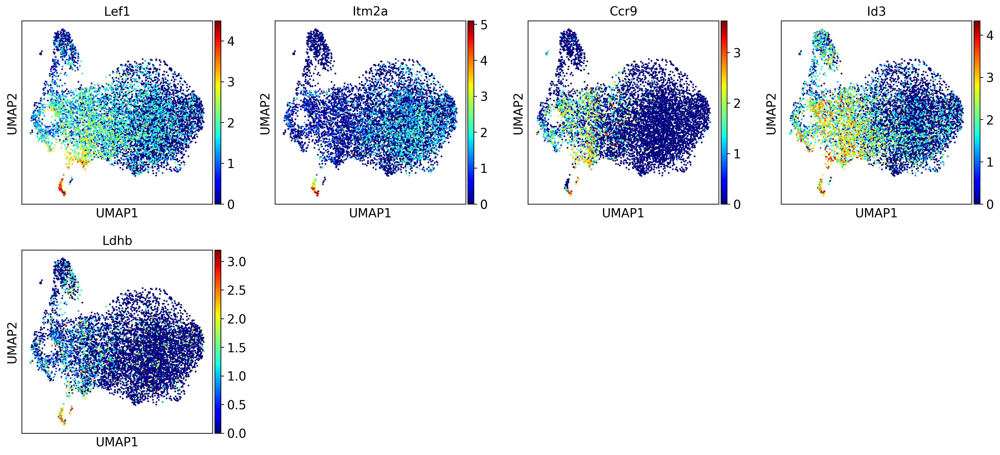

In [28]:
sc.pl.umap(adata, color=['Lef1','Itm2a','Ccr9','Id3','Ldhb'], color_map="jet") # NKT0

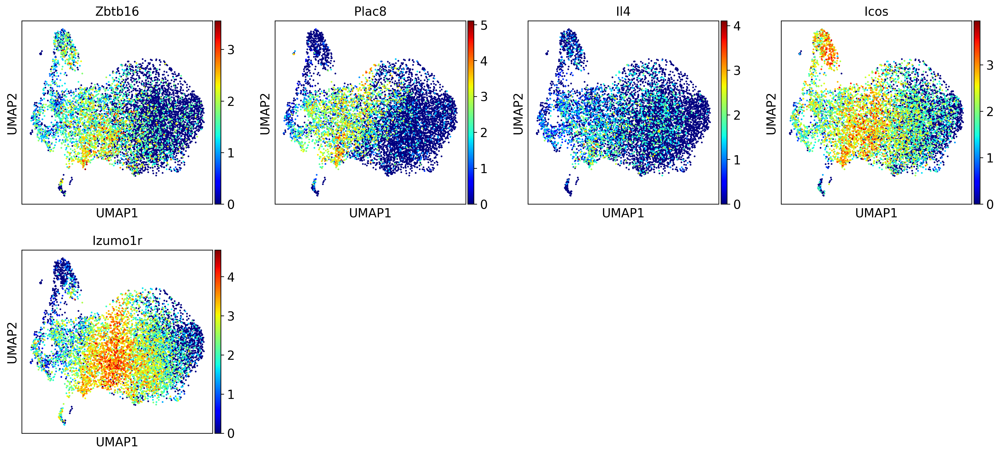

In [29]:
sc.pl.umap(adata, color=['Zbtb16','Plac8','Il4','Icos','Izumo1r'], color_map="jet") # NKT2

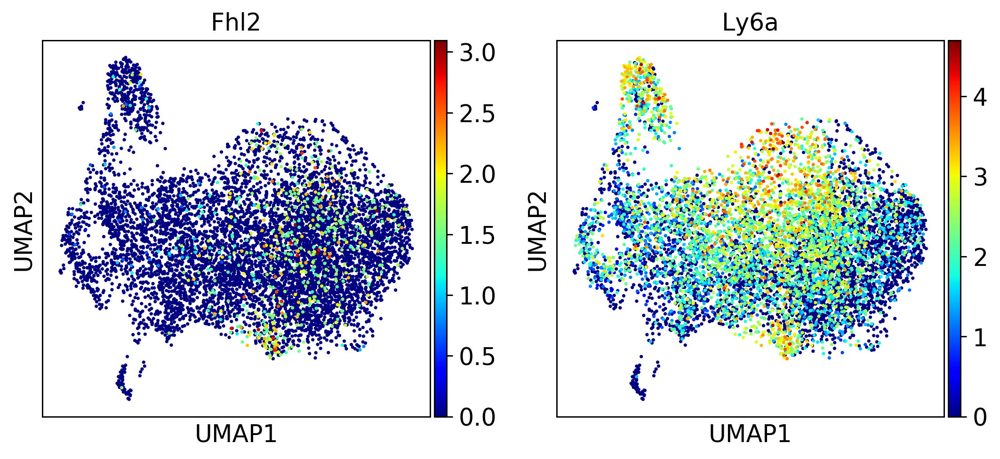

In [30]:
sc.pl.umap(adata, color=['Fhl2','Ly6a'], color_map="jet") # NKT1a

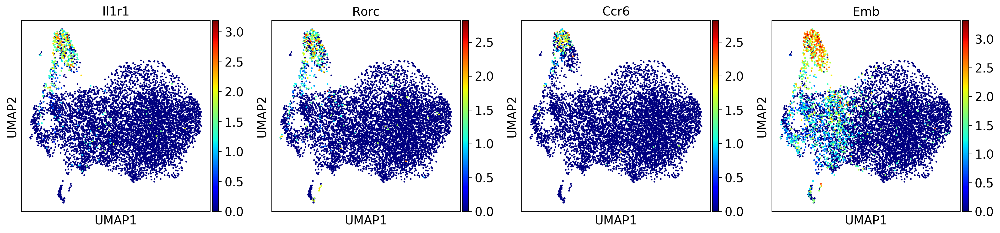

In [31]:
sc.pl.umap(adata, color=['Il1r1', 'Rorc','Ccr6','Emb'], color_map="jet") # NKT17

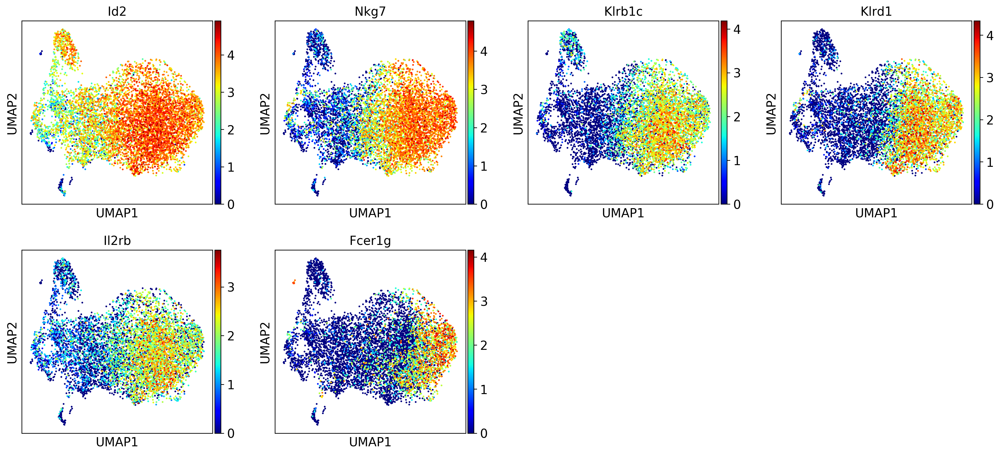

In [32]:
sc.pl.umap(adata, color=['Id2','Nkg7','Klrb1c','Klrd1','Il2rb','Fcer1g'], color_map="jet") # NKT1

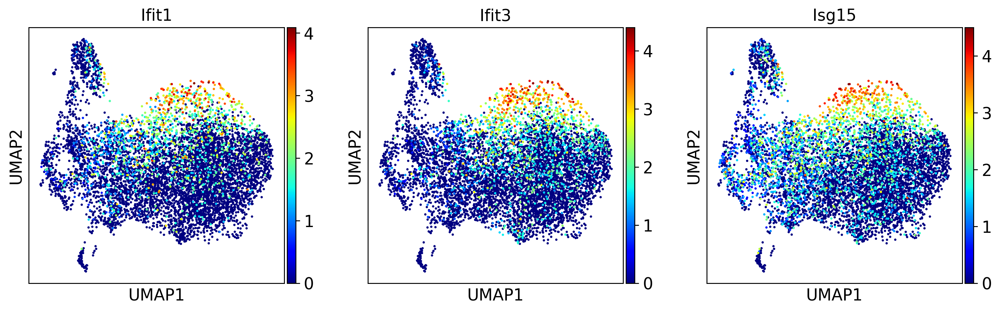

In [33]:
sc.pl.umap(adata, color=['Ifit1','Ifit3','Isg15'], color_map="jet") # NKT1d

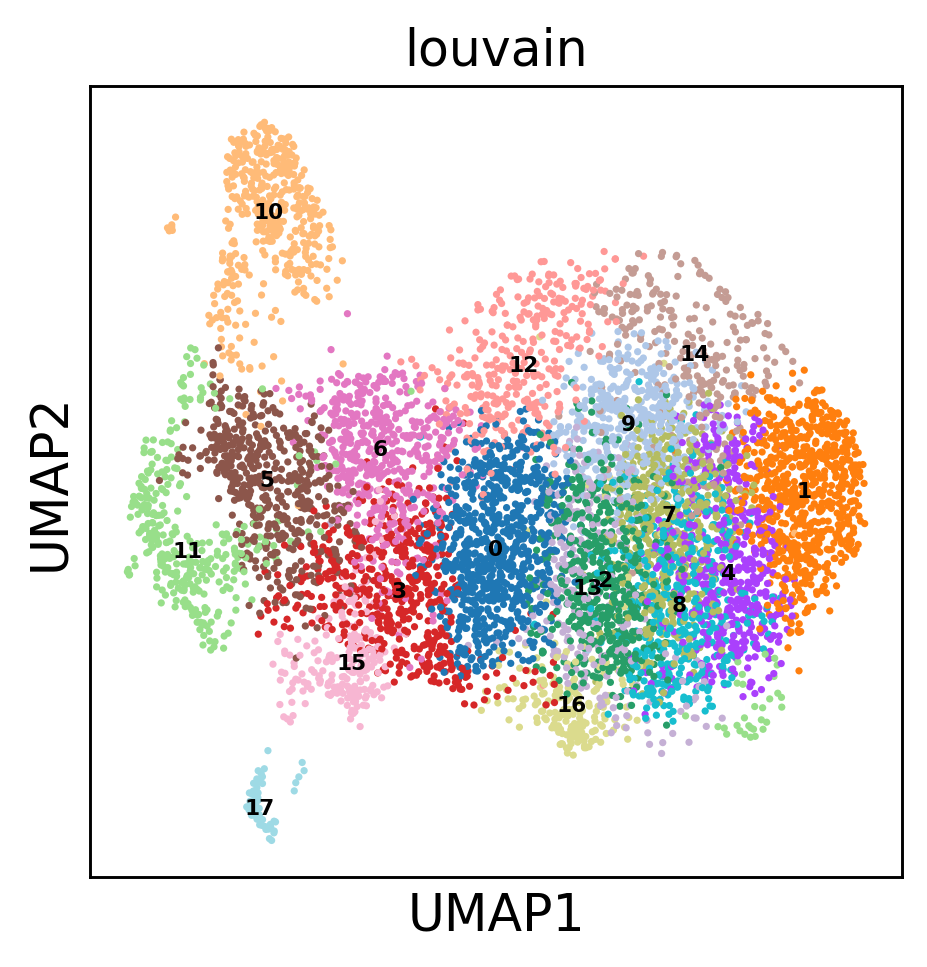

In [34]:
sc.settings.set_figure_params(dpi=130)
sc.pl.umap(adata, color=['louvain'], legend_loc = 'on data', legend_fontsize = 6)

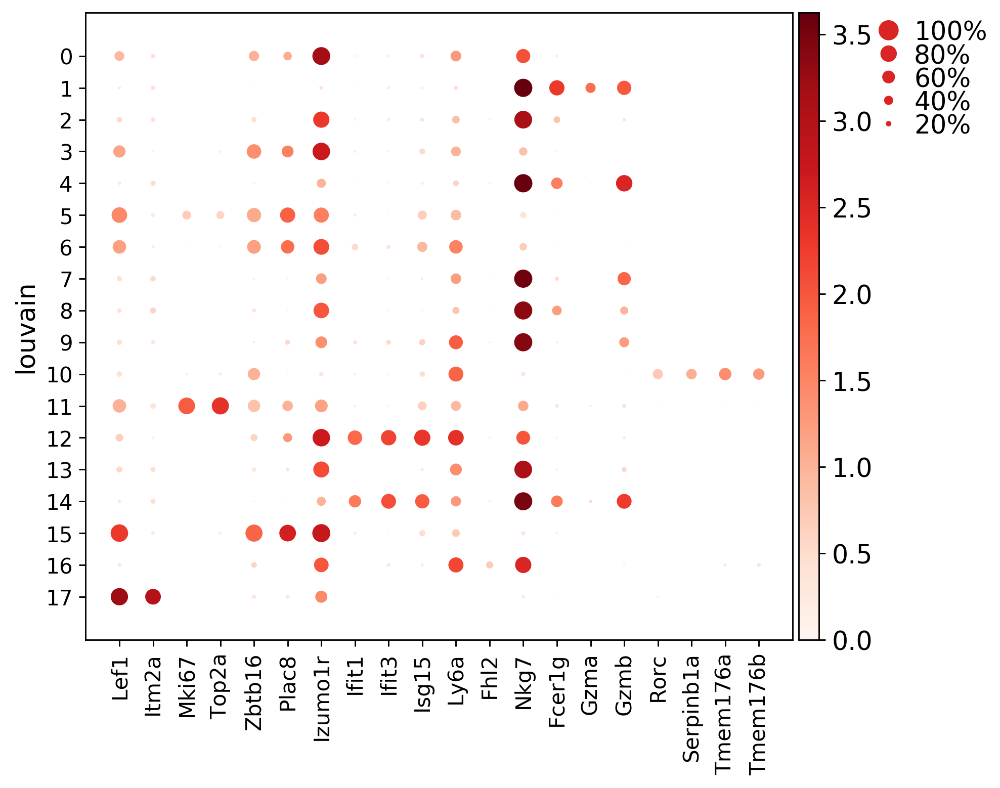

In [35]:
marker_genes = ['Lef1','Itm2a','Mki67','Top2a','Zbtb16','Plac8','Izumo1r','Ifit1','Ifit3','Isg15','Ly6a','Fhl2','Nkg7','Fcer1g','Gzma','Gzmb','Rorc','Serpinb1a','Tmem176a','Tmem176b']
ax = sc.pl.dotplot(adata, marker_genes, groupby='louvain')

In [36]:
mean_cellType = np.empty((len(adata.obs['louvain'].unique()), adata.raw.shape[1]), 
                           dtype=float, order='C')

In [37]:
raw_adata = adata.raw.X.toarray()

In [38]:
for i in range(0, len(adata.obs['louvain'].unique())):
    #print(adata.obs['phenograph'].unique()[i])
    mean_cellType[i,:] = np.mean(raw_adata[adata.obs['louvain'] == adata.obs['louvain'].unique()[i], :], axis = 0)

In [39]:
mean_df = pd.DataFrame(np.corrcoef(mean_cellType), index = adata.obs['louvain'].unique(), columns = adata.obs['louvain'].unique())

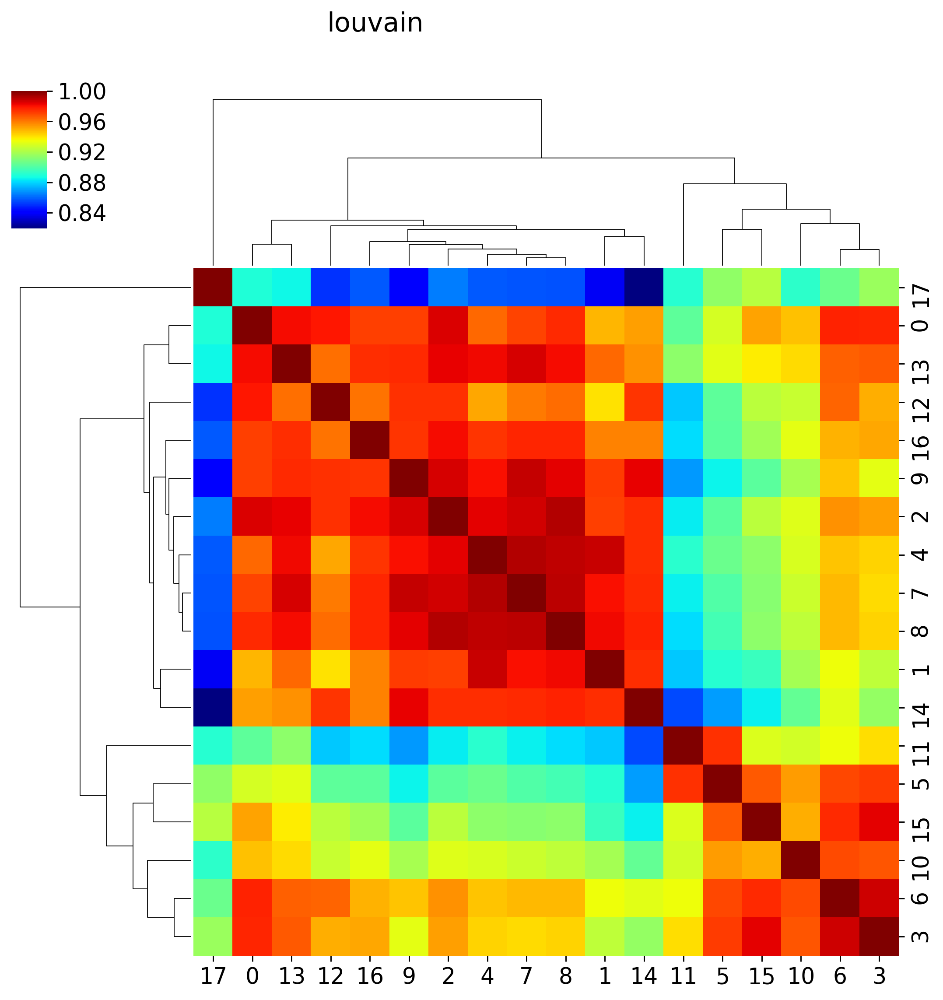

In [40]:
import seaborn
ax = seaborn.clustermap(mean_df, cmap="jet").fig.suptitle('louvain') 

In [41]:
new_cluster_names = {
    '0':'NKT2b', '1':'NKT1c', '2':'NKT1b', '3':'NKT2a', '4':'NKT1c', # 0-4
    '5':'Cycling NKT','6':'NKT2a', '7':'NKT1b', '8':'NKT1b', '9':'NKT1b', '10':'NKT17',
    '11':'Cycling NKT','12':'NKT1d', '13':'NKT1b', '14':'NKT1d', '15':'NKT2a', '16':'NKT1a', '17':'NKT0'} # 6 and 7 could be also Cycling NKT

vect = []
for i in range(0, len(adata.obs['louvain'])):
    vect = vect + [new_cluster_names[str(adata.obs['louvain'][i])]]
    
adata.obs['cell_type'] = vect
adata.uns['cell_type_colors'] = [
                                '#F3766E', # Cycling NKT 
                                '#A31E22', # NKT0
                                '#50C878', # NKT1a
                                '#2E8B57', # NKT1b
                                '#0B6623', # NKT1c
                                '#4CBB17', # NKT1d
                                '#FEC85A', # NKT2a
                                '#FAE600', # NKT2b
                                '#2da9d2'] # NKT17

... storing 'cell_type' as categorical


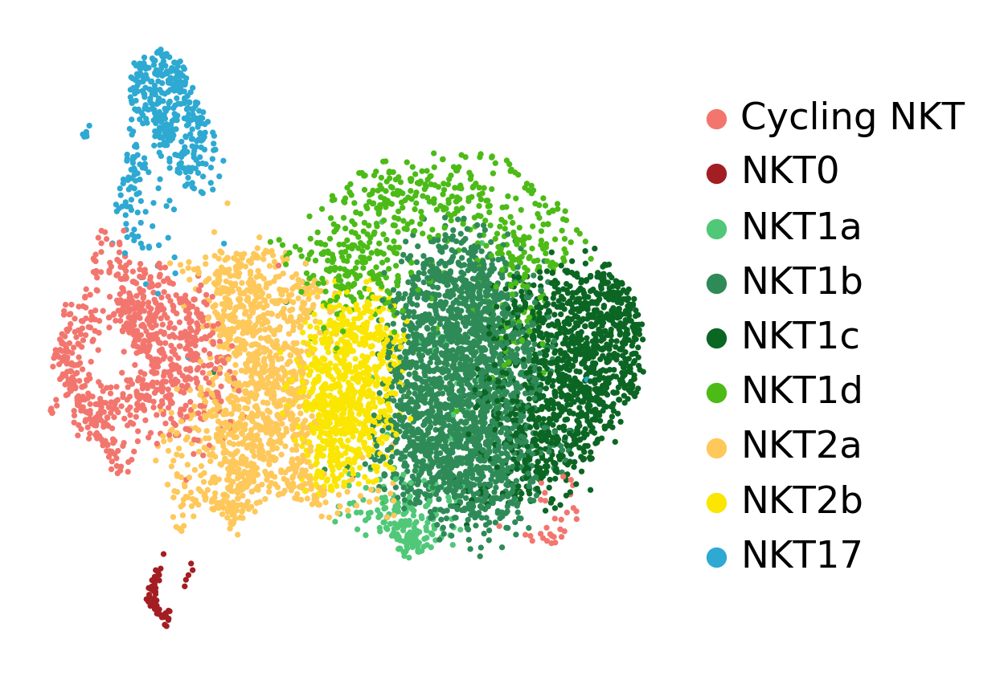

In [42]:
sc.pl.umap(adata, color='cell_type', title='', frameon=False)

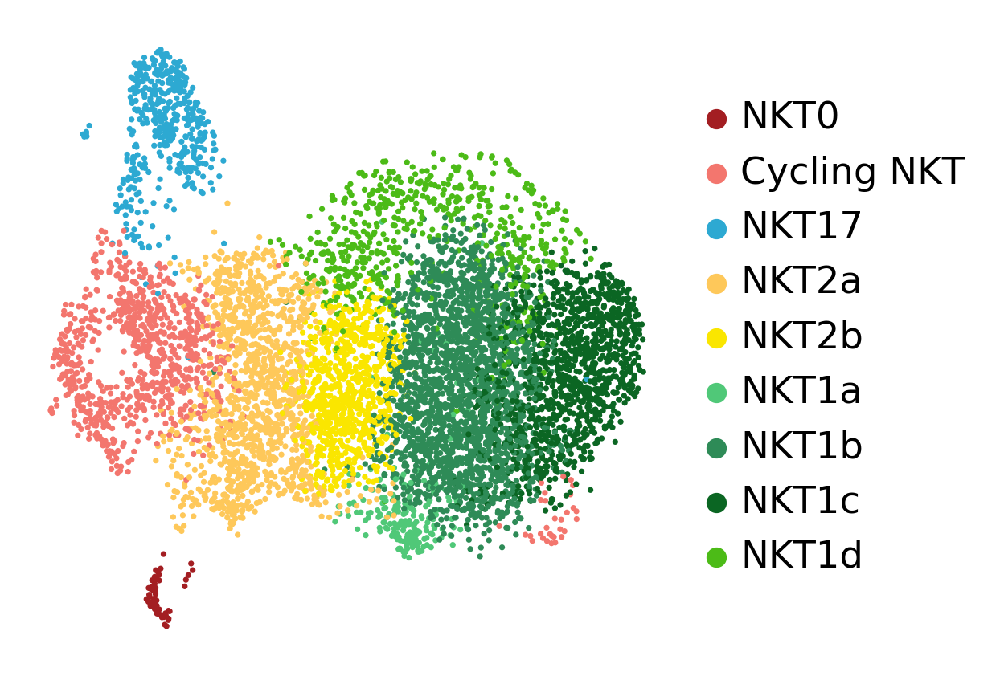

In [43]:
adata.obs['cell_type'].cat.categories
adata.obs['cell_type'].cat.reorder_categories(['NKT0','Cycling NKT','NKT17','NKT2a','NKT2b','NKT1a','NKT1b','NKT1c','NKT1d'], inplace = True)
adata.uns['cell_type_colors'] = [ '#A31E22', # NKT0
                                  '#F3766E', # Cycling NKT
                                  '#2da9d2', # NKT17
                                  '#FEC85A', # NKT2a
                                  '#FAE600', # NKT2b
                                  '#50C878', # NKT1a
                                  '#2E8B57', # NKT1b
                                  '#0B6623', # NKT1c
                                  '#4CBB17'] # NKT1d

sc.pl.umap(adata, color='cell_type', title='', frameon=False, save='figure.8e.pdf')

In [44]:
prop = get_cluster_proportions(adata,"sample","cell_type")
prop

sample,ko,wt
cell_type,,
NKT0,64.285714,35.714286
Cycling NKT,81.367925,18.632075
NKT17,78.088578,21.911422
NKT2a,67.323481,32.676519
NKT2b,68.693402,31.306598
NKT1a,6.310680,93.689320
NKT1b,43.009754,56.990246
NKT1c,41.583333,58.416667
NKT1d,56.292517,43.707483


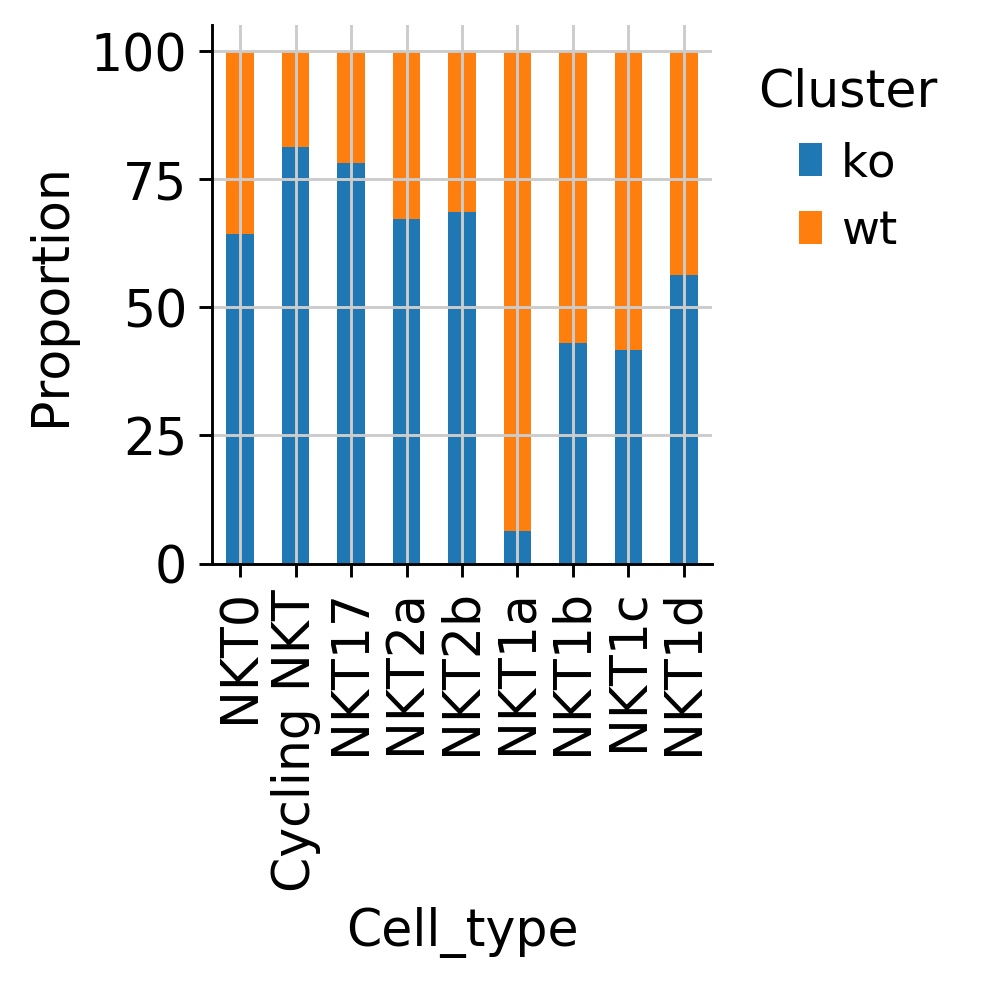

In [45]:
plot = plot_cluster_proportions(prop, cluster_palette=None, xlabel_rotation=90)

In [46]:
prop = get_cluster_proportions(adata,"cell_type","sample")
prop

cell_type,NKT0,Cycling NKT,NKT17,NKT2a,NKT2b,NKT1a,NKT1b,NKT1c,NKT1d
sample,,,,,,,,,
ko,0.861038,16.503229,8.012437,19.612533,12.700311,0.310930,22.147812,11.934944,7.916766
wt,0.607903,4.802432,2.857143,12.097264,7.355623,5.866261,37.294833,21.306991,7.811550


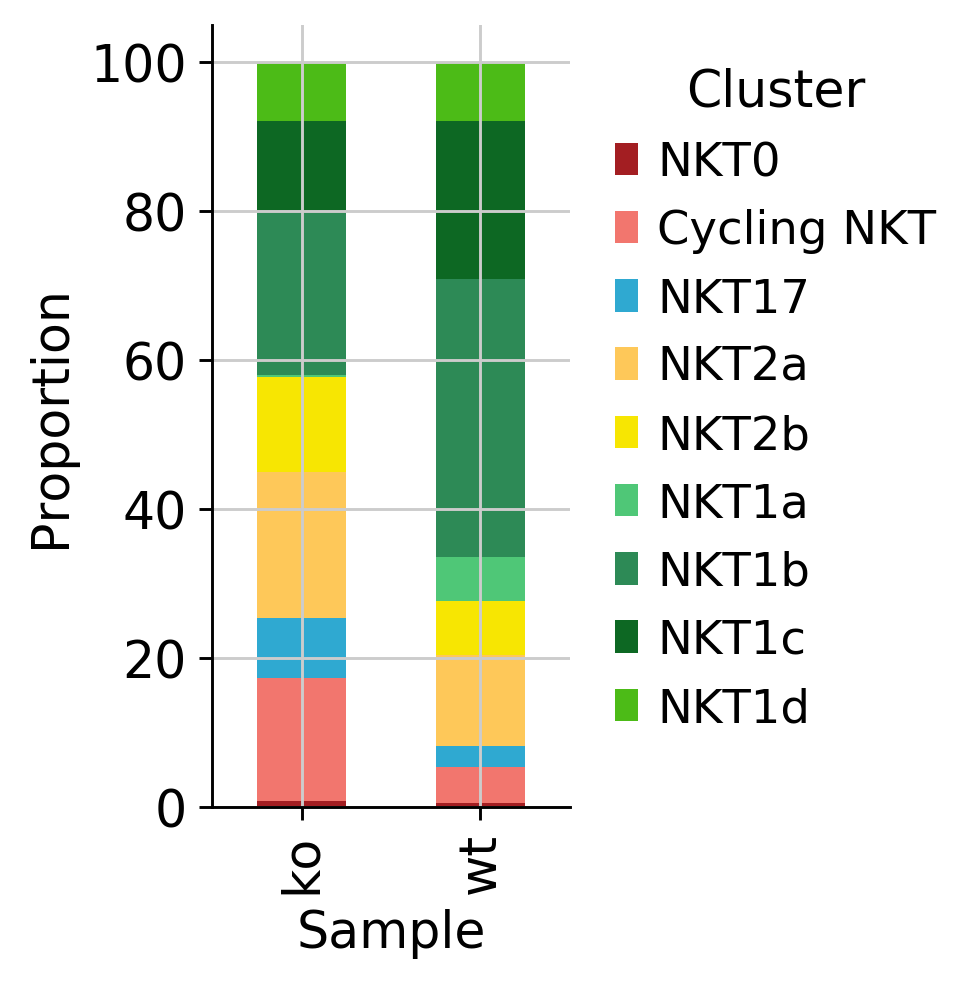

In [47]:
colors = ['#A31E22','#F3766E','#2da9d2','#FEC85A','#FAE600','#50C878','#2E8B57','#0B6623','#4CBB17']
plot = plot_cluster_proportions(prop, cluster_palette=colors, xlabel_rotation=90)
plot.savefig("figure.7e.pdf", dpi=300)

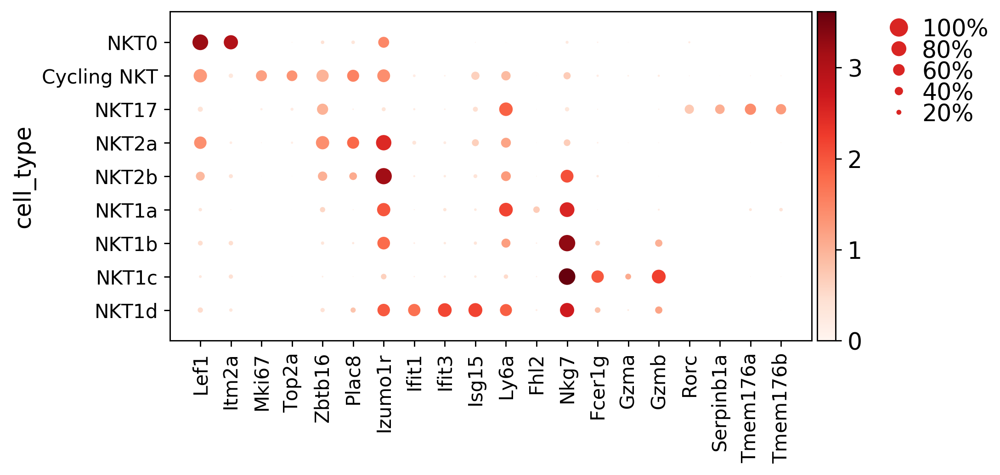

In [48]:
marker_genes = ['Lef1','Itm2a','Mki67','Top2a','Zbtb16','Plac8','Izumo1r','Ifit1','Ifit3','Isg15','Ly6a','Fhl2','Nkg7','Fcer1g','Gzma','Gzmb','Rorc','Serpinb1a','Tmem176a','Tmem176b']
ax = sc.pl.dotplot(adata, marker_genes, groupby='cell_type')

In [49]:
adata.obs['umap_1'] = pd.DataFrame(adata.obsm['X_umap']).iloc[:,0].tolist()
adata.obs['umap_2'] = pd.DataFrame(adata.obsm['X_umap']).iloc[:,1].tolist()
adata.obs.to_csv(path_or_buf = 'output/metadata.aggr.tsv', sep = '\t', index = True)

In [50]:
adata.obsm

AxisArrays with keys: X_pca, X_umap

In [51]:
color_dictionnary = {
    'Cycling NKT':'#F3766E',
    'NKT0':'#A31E22',
    'NKT1a':'#50C878',
    'NKT1b':'#2E8B57',
    'NKT1c':'#0B6623',
    'NKT1d':'#4CBB17',
    'NKT2a':'#FEC85A',
    'NKT2b':'#FAE600',
    'NKT17': '#2da9d2',
}

df = pd.DataFrame.from_dict(color_dictionnary, orient = 'index', columns = ['color'])
df.to_csv(path_or_buf = 'cellbrowser/aggr/clusterColor.tsv', sep = '\t', index_label = 'Cluster')

In [52]:
adata.write('./output/aggr.ann.h5ad')

In [53]:
sc.external.exporting.cellbrowser(adata, 
                                 'cellbrowser/aggr', 
                                 'aggr', 
                                  annot_keys=['cell_type', 'louvain', 'sample', 
                                              'n_counts', 'n_genes', 'percent_mito', 'percent_ribo'], 
                                 cluster_field='cell_type', nb_marker=30,
                                 skip_matrix=False, do_debug=True)

INFO:root:Writing scanpy matrix (7471 cells, 12667 genes) to cellbrowser/aggr/exprMatrix.tsv.gz
INFO:root:Transposing matrix
INFO:root:Writing gene-by-gene, without using pandas
INFO:root:Writing 12667 genes in total
INFO:root:Wrote 0 genes
INFO:root:Wrote 2000 genes
INFO:root:Wrote 4000 genes
INFO:root:Wrote 6000 genes
INFO:root:Wrote 8000 genes
INFO:root:Wrote 10000 genes
INFO:root:Wrote 12000 genes
DEBUG:root:Compressing cellbrowser/aggr/exprMatrix.tsv.gz.tmp
DEBUG:root:Running gzip -f cellbrowser/aggr/exprMatrix.tsv.gz.tmp
DEBUG:root:Renaming cellbrowser/aggr/exprMatrix.tsv.gz.tmp.gz to cellbrowser/aggr/exprMatrix.tsv.gz
DEBUG:root:Couldnt find coordinates for ForceAtlas2, tried keys fa, X_fa and X_draw_graph_fa
DEBUG:root:Couldnt find coordinates for Fruchterman Reingold, tried keys fr, X_fr and X_draw_graph_fr
DEBUG:root:Couldnt find coordinates for Grid Fruchterman Reingold, tried keys grid_fr, X_grid_fr and X_draw_graph_grid_fr
DEBUG:root:Couldnt find coordinates for Kamadi Kaw

# density plot

In [54]:
sc.tl.embedding_density(adata, basis='umap', groupby='sample')

computing density on 'umap'
--> added
    'umap_density_sample', densities (adata.obs)
    'umap_density_sample_params', parameter (adata.uns)


DEBUG:matplotlib.colorbar:locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x7fcb47f99390>
DEBUG:matplotlib.colorbar:Using auto colorbar locator on colorbar
DEBUG:matplotlib.colorbar:locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x7fcb47f99390>
DEBUG:matplotlib.colorbar:Setting pcolormesh


DEBUG:matplotlib.backends.backend_pdf:Assigning font /b'F1' = '/home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf'
DEBUG:matplotlib.backends.backend_pdf:Embedding font /home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf.
DEBUG:matplotlib.backends.backend_pdf:Writing TrueType font.
DEBUG:matplotlib.backends.backend_pdf:Assigning font /b'F1' = '/home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf'
DEBUG:matplotlib.backends.backend_pdf:Embedding font /home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf.
DEBUG:matplotlib.backends.backend_pdf:Writing TrueType font.


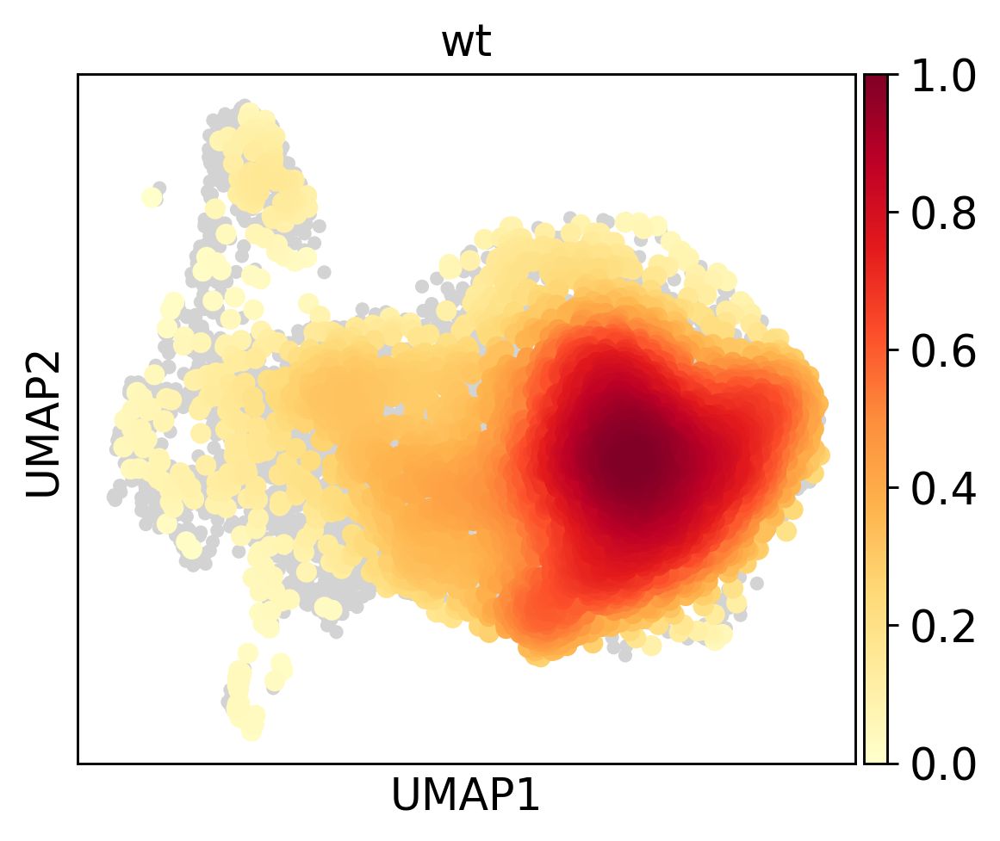

DEBUG:matplotlib.colorbar:locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x7fcb480f6dd0>
DEBUG:matplotlib.colorbar:Using auto colorbar locator on colorbar
DEBUG:matplotlib.colorbar:locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x7fcb480f6dd0>
DEBUG:matplotlib.colorbar:Setting pcolormesh


DEBUG:matplotlib.backends.backend_pdf:Assigning font /b'F1' = '/home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf'
DEBUG:matplotlib.backends.backend_pdf:Embedding font /home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf.
DEBUG:matplotlib.backends.backend_pdf:Writing TrueType font.
DEBUG:matplotlib.backends.backend_pdf:Assigning font /b'F1' = '/home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf'
DEBUG:matplotlib.backends.backend_pdf:Embedding font /home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf.
DEBUG:matplotlib.backends.backend_pdf:Writing TrueType font.


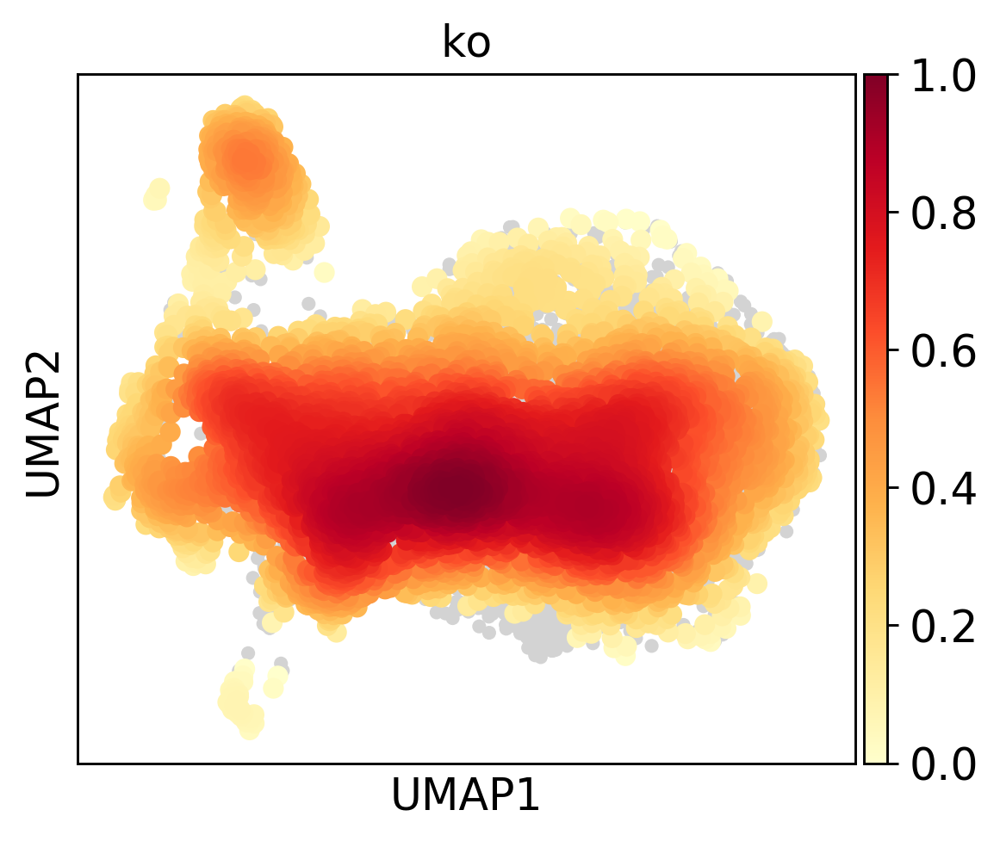

In [55]:
adata.obs['sample'].value_counts()
sc.pl.embedding_density(adata, basis='umap', key='umap_density_sample', group='wt', save="wt.pdf")
sc.pl.embedding_density(adata, basis='umap', key='umap_density_sample', group='ko', save="ko.pdf")